In [1]:
from Util.pyDialogue import *
import numpy as np
import matplotlib.pyplot as plt

In [7]:
img = np.load(askFILE())[0,...]

img1 = img/np.max(img) * 255
img1 = img1.astype(np.float32)
img = img.astype(np.float32)

In [4]:
from sewar.full_ref import ssim, msssim

ssim(img,img+np.random.randint(0,256,img.shape))

c:\Users\belav\AppData\Local\Programs\Python\Python39\lib\site-packages\sewar\utils.py:18: UserWarning: Supplied images have different dtypes uint16 and int32
  warnings.warn(msg)


(0.9625354447509068, 0.9986017939058244)

In [8]:
ssim(img, img1, ws = 11, mode = 'same')

ValueError: Invalid integer data type 'f'.

In [6]:
msssim(img,img+np.random.randint(0,256,img.shape))

(0.9949270126954539+0j)

In [3]:
img.shape

(4000, 4000)

In [9]:
type(img)

numpy.ndarray

In [ ]:
transforms.T

In [26]:
from torchvision import transforms

pre_prep = transforms.Compose(
    [transforms.ToTensor()]
)

prep = transforms.Compose([
    transforms.Normalize(img.mean(), img.std())
])

In [19]:
(0.229+0.224+0.225)/3

0.226

In [15]:
test_trans = transforms.Compose([
    pre_prep,
    prep
])

In [15]:
import torch

In [12]:
img = pre_prep(img)

In [30]:
%%timeit
test = pre_prep(img.astype('float32'))

46.5 µs ± 577 ns per loop (mean ± std. dev. of 7 runs, 10,000 loops each)


In [37]:
import torch
torch.from_numpy(img.astype('float32')).shape

torch.Size([256, 256])

In [36]:
%%timeit
test = torch.from_numpy(img.astype(np.float32))

39.7 µs ± 359 ns per loop (mean ± std. dev. of 7 runs, 10,000 loops each)


In [17]:
%%timeit
pre_prep(img).mean()
pre_prep(img).std()

347 µs ± 11.3 µs per loop (mean ± std. dev. of 7 runs, 1,000 loops each)


In [16]:
%%timeit
test_img = test_trans(img)

177 µs ± 2.35 µs per loop (mean ± std. dev. of 7 runs, 10,000 loops each)


In [35]:
%%timeit
pre_prep_img = pre_prep(img)
prep_img = prep(pre_prep_img)

178 µs ± 5 µs per loop (mean ± std. dev. of 7 runs, 10,000 loops each)


In [12]:
%%timeit
prep_img = (pre_prep(img) - pre_prep(img).mean()/pre_prep(img).std())

455 µs ± 13.8 µs per loop (mean ± std. dev. of 7 runs, 1,000 loops each)


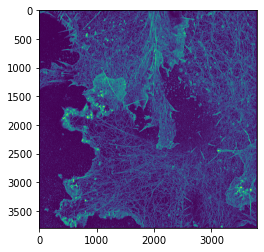

In [47]:
import matplotlib.pyplot as plt

plt.imshow(img[...])

In [18]:
img = pre_prep(img.astype(np.float32))

In [22]:
prep_img = prep(img)

In [23]:
prep_img = ((img - img.mean())/img.std())

In [24]:
# print mean and std
print("Mean and Std of normalized image:")
print("Mean of the image:", prep_img.mean())
print("Std of the image:", prep_img.std())

Mean and Std of normalized image:
Mean of the image: tensor(8.6147e-09)
Std of the image: tensor(1.)


In [22]:
prep_img.shape

torch.Size([1, 256, 256])

Text(0.5, 1.0, 'distribution of pixels')

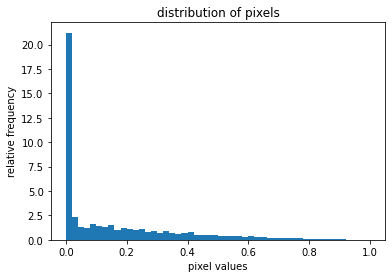

In [8]:

# Python code for converting PIL Image to
# PyTorch Tensor image and plot pixel values
 
# import necessary libraries
import torchvision.transforms as transforms
import matplotlib.pyplot as plt
 
# define custom transform function
transform = transforms.Compose([
    transforms.ToTensor()
])
 
# transform the pIL image to tensor
# image
img_tr = transform(img)
 
# Convert tensor image to numpy array
img_np = np.array(img_tr)
 
# plot the pixel values
plt.hist(img_np.ravel(), bins=50, density=True)
plt.xlabel("pixel values")
plt.ylabel("relative frequency")
plt.title("distribution of pixels")

In [9]:
# Python code to calculate mean and std
# of image
 
# get tensor image
img_tr = transform(img)
 
# calculate mean and std
mean, std = img_tr.mean([1,2]), img_tr.std([1,2])
 
# print mean and std
print("mean and std before normalize:")
print("Mean of the image:", mean)
print("Std of the image:", std)

mean and std before normalize:
Mean of the image: tensor([0.1578])
Std of the image: tensor([0.2059])


Text(0.5, 1.0, 'distribution of pixels')

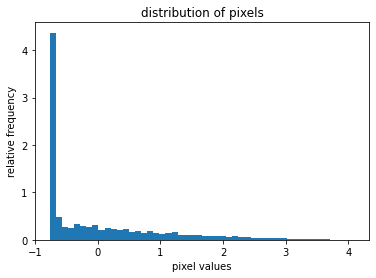

In [17]:

# python code to normalize the image
 
 
from torchvision import transforms
 
# define custom transform
# here we are using our calculated
# mean & std
transform_norm = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize(mean, std)
])
 
# get normalized image
img_normalized = transform_norm(img)
 
# convert normalized image to numpy
# array
img_np = np.array(img_normalized)
 
# plot the pixel values
plt.hist(img_np.ravel(), bins=50, density=True)
plt.xlabel("pixel values")
plt.ylabel("relative frequency")
plt.title("distribution of pixels")

In [20]:

# Python code to calculate mean and std
# of normalized image
 
# get normalized image
img_nor = transform_norm(img)
 
# cailculate mean and std
mean, std = img_nor.mean([1,2]), img_nor.std([1,2])
 
# print mean and std
print("Mean and Std of normalized image:")
print("Mean of the image:", mean)
print("Std of the image:", std)

Mean and Std of normalized image:
Mean of the image: tensor([-1.0952e-07])
Std of the image: tensor([1.0000])


In [25]:
files = askFILES()

In [ ]:
from skimage.io import imread
for file in files:
    print(np.max(np.array(imread(file))))

In [30]:
from skimage.io import imread
files = askFILES()
for file in files:
    img = np.array(np.load(file))
    print(np.max(img))
    print(type(img[0,0]))
    print(img.shape)

255
<class 'numpy.uint8'>
(6541, 6541)
255
<class 'numpy.uint8'>
(6541, 6541)
255
<class 'numpy.uint8'>
(6541, 6541)
255
<class 'numpy.uint8'>
(6541, 6541)
255
<class 'numpy.uint8'>
(4263, 6541)
255
<class 'numpy.uint8'>
(6541, 6541)
255
<class 'numpy.uint8'>
(3316, 6541)
255
<class 'numpy.uint8'>
(6541, 6541)
255
<class 'numpy.uint8'>
(6541, 6541)
255
<class 'numpy.uint8'>
(6541, 6541)
255
<class 'numpy.uint8'>
(3779, 3777)
255
<class 'numpy.uint8'>
(3784, 3693)
255
<class 'numpy.uint8'>
(3777, 3781)
255
<class 'numpy.uint8'>
(3879, 6541)
255
<class 'numpy.uint8'>
(3316, 6541)
255
<class 'numpy.uint8'>
(6541, 6541)
255
<class 'numpy.uint8'>
(6541, 6541)
255
<class 'numpy.uint8'>
(5159, 6541)


In [1]:
from Util.pyDialogue import *
import numpy as np
import matplotlib.pyplot as plt
import os

255
255
255
255
255
255
255
255
255
255
255
255
255


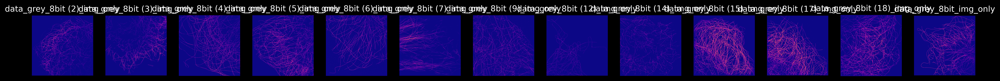

In [6]:
files = askFILES()
plt.style.use('dark_background')
fig, axs = plt.subplots(1,len(files), figsize =(25,5), dpi = 500) 
for i,file in enumerate(files):
    axs[i].set_title(os.path.basename(file)[:-4])
    axs[i].imshow(np.load(file)[...], cmap = 'plasma')
    axs[i].axis('off')
    print(np.max(np.load(file)[...]))
plt.show()

255
255
255
255


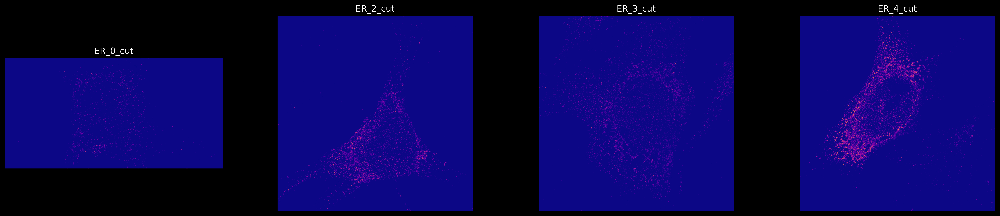

In [4]:
files = askFILES()
plt.style.use('dark_background')
fig, axs = plt.subplots(1,len(files), figsize =(25,5), dpi = 500) 
for i,file in enumerate(files):
    axs[i].set_title(os.path.basename(file)[:-4])
    axs[i].imshow(np.load(file)[...], cmap = 'plasma')
    axs[i].axis('off')
    print(np.max(np.load(file)[...]))
plt.show()

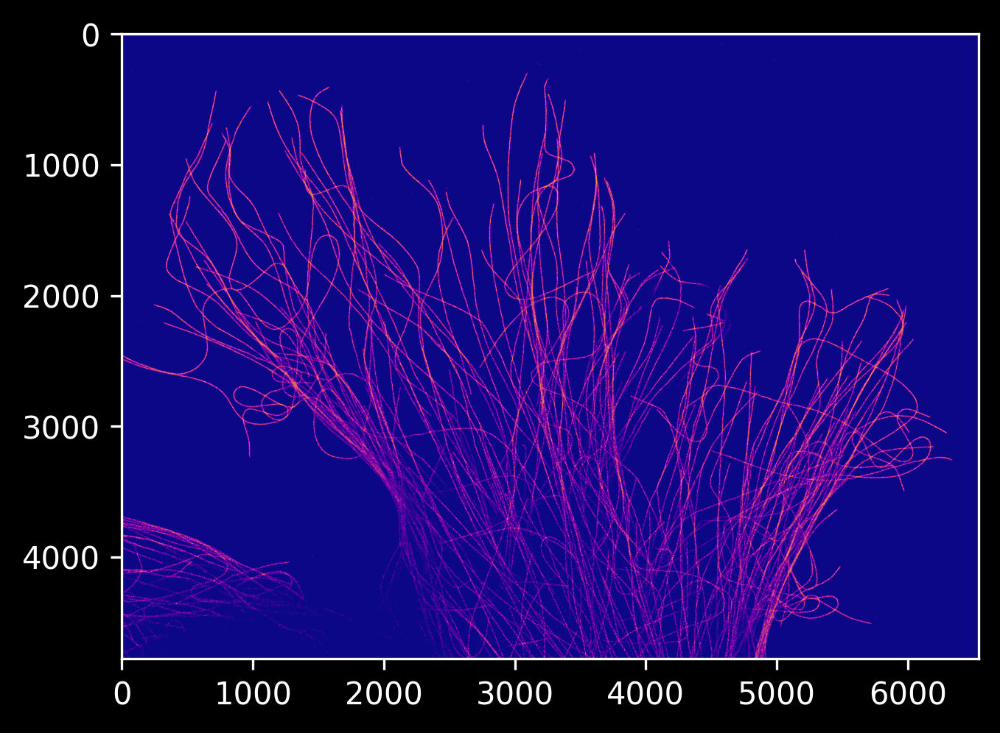

In [4]:
plt.figure(figsize = (5,5), dpi = 300)
plt.imshow(np.load(askFILE())[...], cmap = 'plasma')

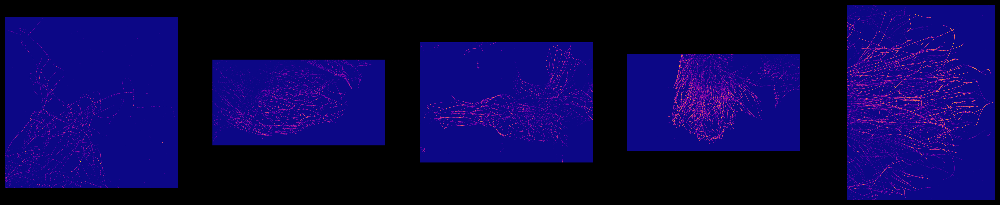

In [27]:
files = askFILES()
plt.style.use('dark_background')
fig, axs = plt.subplots(1,len(files), figsize =(25,5), dpi = 500) 
for i,file in enumerate(files):
    axs[i].imshow(np.load(file)[...], cmap = 'plasma')
    axs[i].axis('off')
plt.show()

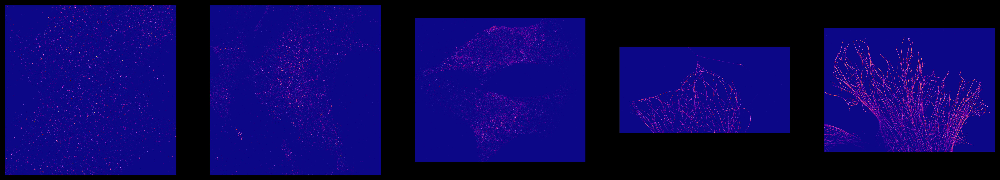

In [19]:
files = askFILES()
plt.style.use('dark_background')
fig, axs = plt.subplots(1,len(files), figsize =(25,5), dpi = 500) 
for i,file in enumerate(files):
    axs[i].imshow(np.load(file)[...], cmap = 'plasma')
    axs[i].axis('off')
plt.show()

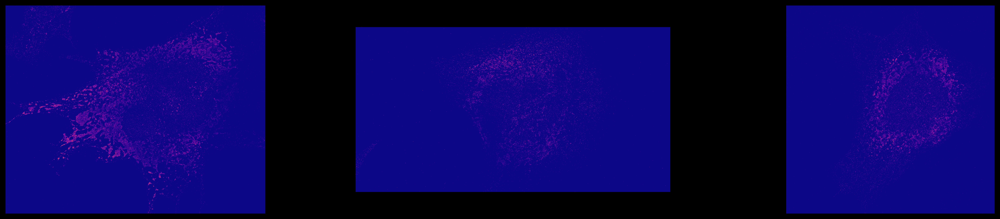

In [18]:
files = askFILES()
plt.style.use('dark_background')
fig, axs = plt.subplots(1,len(files), figsize =(25,5), dpi = 500) 
for i,file in enumerate(files):
    axs[i].imshow(np.load(file)[...], cmap = 'plasma')
    axs[i].axis('off')
plt.show()

In [4]:
from skimage.io import imread

import glob
for file in glob.glob(askDIR()+"/*.tif"):
    img = imread(file).astype(np.uint8)
    #img = img/np.max(img) * 255
    #img = img.astype('uint8')
    np.save(file[:-4]+"_rescaled.npy", img)

In [ ]:
img = np.load(askFILE())